# Try retrain pretrained ImageNet models availible in Keras

In [2]:
%reload_ext autoreload
%autoreload 2
%matplotlib inline

In [3]:
from keras.applications import VGG16
import matplotlib.pyplot as plt

# Load model and data

In [4]:
image_size = 256
train_folder = "Images/train/"
test_folder = "Images/test/"

Load model. Freeze all layers. Add three more layers for training

In [5]:
#Load the VGG model
vgg_conv = VGG16(weights='imagenet', include_top=False, input_shape=(image_size, image_size, 3))

# Freeze all the layers
for layer in vgg_conv.layers[:]:
    layer.trainable = False

# Check the trainable status of the individual layers
for layer in vgg_conv.layers:
    print(layer, layer.trainable)


from keras import models
from keras import layers
from keras import optimizers

# Create the model
model = models.Sequential()

# Add the vgg convolutional base model
model.add(vgg_conv)

# Add new layers
model.add(layers.Flatten())
model.add(layers.Dense(1024, activation='relu'))
model.add(layers.Dropout(0.5))
model.add(layers.Dense(21, activation='softmax'))

# Show a summary of the model. Check the number of trainable parameters
model.summary()

<keras.engine.topology.InputLayer object at 0x7f85e8578550> False
<keras.layers.convolutional.Conv2D object at 0x7f85e8578828> False
<keras.layers.convolutional.Conv2D object at 0x7f85e85787b8> False
<keras.layers.pooling.MaxPooling2D object at 0x7f85e8593a20> False
<keras.layers.convolutional.Conv2D object at 0x7f85e8544748> False
<keras.layers.convolutional.Conv2D object at 0x7f85e8544860> False
<keras.layers.pooling.MaxPooling2D object at 0x7f85e85586a0> False
<keras.layers.convolutional.Conv2D object at 0x7f85e84ffa58> False
<keras.layers.convolutional.Conv2D object at 0x7f85e8512b38> False
<keras.layers.convolutional.Conv2D object at 0x7f85e8520208> False
<keras.layers.pooling.MaxPooling2D object at 0x7f85e84cf7b8> False
<keras.layers.convolutional.Conv2D object at 0x7f85e8479e10> False
<keras.layers.convolutional.Conv2D object at 0x7f85e8479f28> False
<keras.layers.convolutional.Conv2D object at 0x7f85e84a02e8> False
<keras.layers.pooling.MaxPooling2D object at 0x7f85e844b710> Fa

In [6]:
import os
import numpy as np
train_folders = os.listdir(train_folder)
test_folders = os.listdir(test_folder)

Rotate images and save them  to folder

In [7]:
import matplotlib.pyplot as plt
import cv2
for folder in train_folders:
    files = os.listdir(train_folder + '/' + folder)
    for img in files:
        img_file = cv2.imread(train_folder + '/' + folder + '/' + img)
        img_file_90 = np.rot90(img_file)
        img_file_180 = np.rot90(img_file_90)
        img_file_270 = np.rot90(img_file_180)
        cv2.imwrite(train_folder + '/' + folder + '/' + img[:-4] + '_90.tif', img_file_90)
        cv2.imwrite(train_folder + '/' + folder + '/' + img[:-4] + '_180.tif', img_file_180)
        cv2.imwrite(train_folder + '/' + folder + '/' + img[:-4] + '_270.tif', img_file_270)

KeyboardInterrupt: 

In [39]:
for folder in test_folders:
    files = os.listdir(test_folder + '/' + folder)
    for img in files:
        img_file = cv2.imread(test_folder + '/' + folder + '/' + img)
        img_file_90 = np.rot90(img_file)
        img_file_180 = np.rot90(img_file_90)
        img_file_270 = np.rot90(img_file_180)
        cv2.imwrite(test_folder + '/' + folder + '/' + img[:-4] + '_90.tif', img_file_90)
        cv2.imwrite(test_folder + '/' + folder + '/' + img[:-4] + '_180.tif', img_file_180)
        cv2.imwrite(test_folder + '/' + folder + '/' + img[:-4] + '_270.tif', img_file_270)

KeyboardInterrupt: 

Train model

In [8]:
from keras.preprocessing.image import ImageDataGenerator
# No Data augmentation 
train_datagen = ImageDataGenerator(rescale=1./255)
validation_datagen = ImageDataGenerator(rescale=1./255)

# Change the batchsize according to your system RAM
batch_size = 100


# Data Generator for Training data
train_generator = train_datagen.flow_from_directory(
        train_folder,
        target_size=(image_size, image_size),
        batch_size=train_batchsize,
        class_mode='categorical')

# Data Generator for Validation data
validation_generator = validation_datagen.flow_from_directory(
        test_folder,
        target_size=(image_size, image_size),
        batch_size=val_batchsize,
        class_mode='categorical',
        shuffle=False)

# Compile the model
model.compile(loss='categorical_crossentropy',
              optimizer=optimizers.RMSprop(lr=1e-4),
              metrics=['acc'])

# Train the Model
history = model.fit_generator(
      train_generator, train_generator.n // batch_size, epochs=3, workers=4,
        validation_data=validation_generator, validation_steps=validation_generator.n // batch_size)

# Save the Model
model.save('all_freezed.h5')

# Plot the accuracy and loss curves
acc = history.history['acc']
val_acc = history.history['val_acc']
loss = history.history['loss']
val_loss = history.history['val_loss']

epochs = range(len(acc))

plt.plot(epochs, acc, 'b', label='Training acc')
plt.plot(epochs, val_acc, 'r', label='Validation acc')
plt.title('Training and validation accuracy')
plt.legend()

plt.figure()

plt.plot(epochs, loss, 'b', label='Training loss')
plt.plot(epochs, val_loss, 'r', label='Validation loss')
plt.title('Training and validation loss')
plt.legend()

plt.show()

NameError: name 'train_batchsize' is not defined

In [3]:
from tensorflow.python.client import device_lib
print(device_lib.list_local_devices())

[name: "/cpu:0"
device_type: "CPU"
memory_limit: 268435456
locality {
}
incarnation: 4768531487200997986
, name: "/gpu:0"
device_type: "GPU"
memory_limit: 147193856
locality {
  bus_id: 1
}
incarnation: 9154135836151341539
physical_device_desc: "device: 0, name: GeForce GTX 1070, pci bus id: 0000:01:00.0"
]


Show the errors

Found 1600 images belonging to 21 classes.
100/100 [==============================] - 12s 121ms/step
No of errors = 203/1600


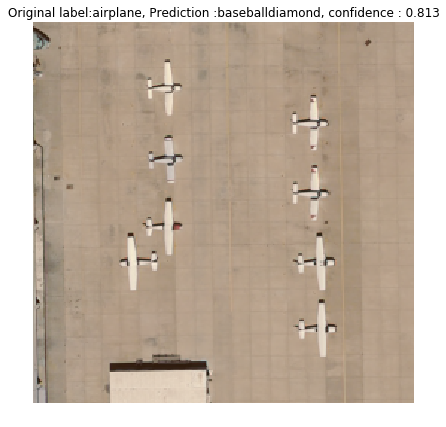

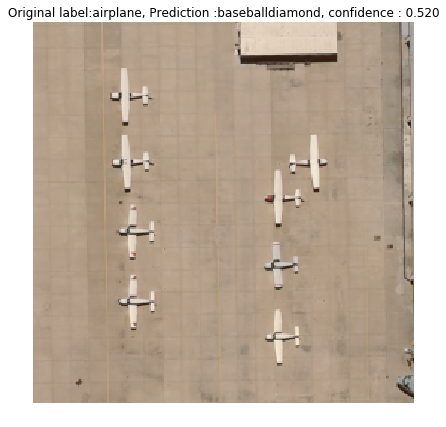

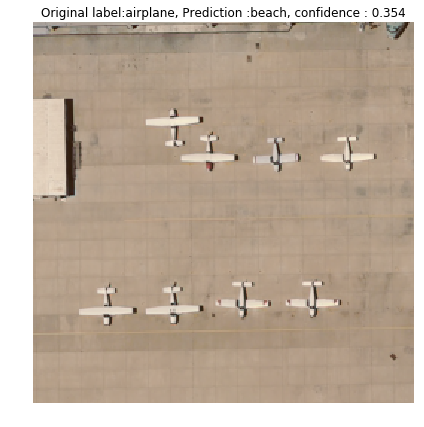

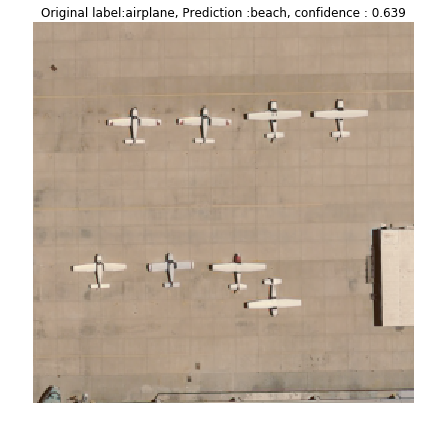

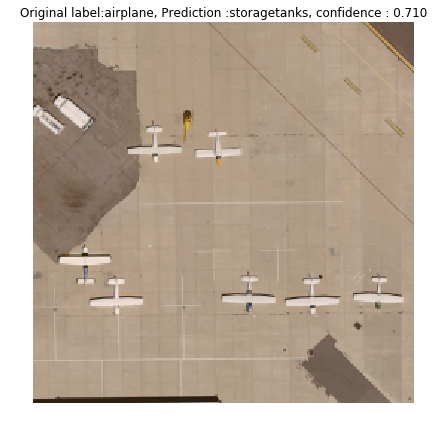

...

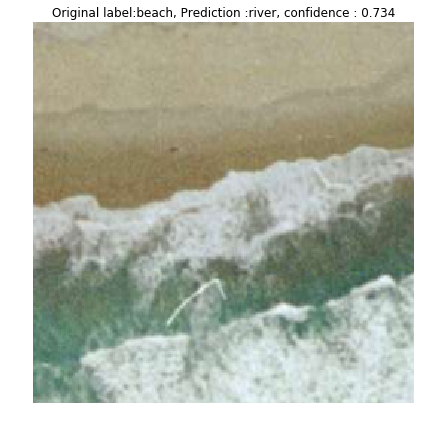

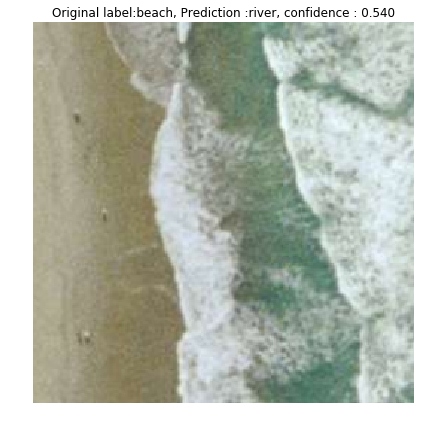

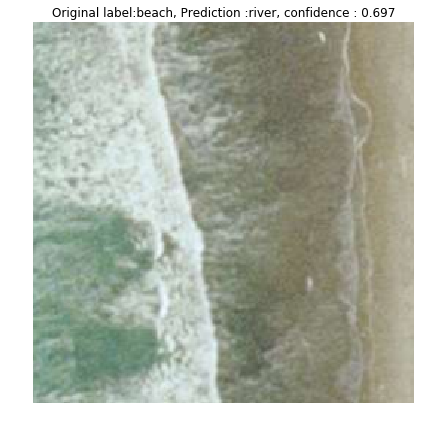

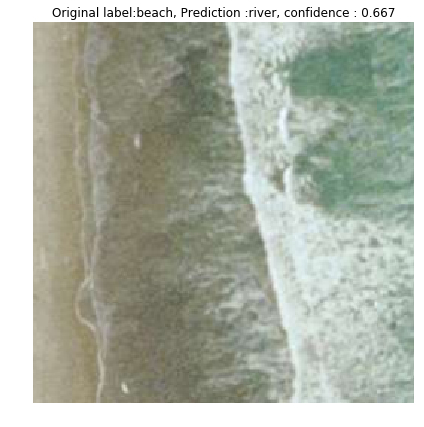

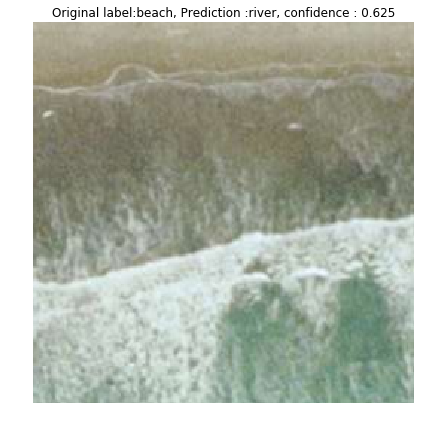

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


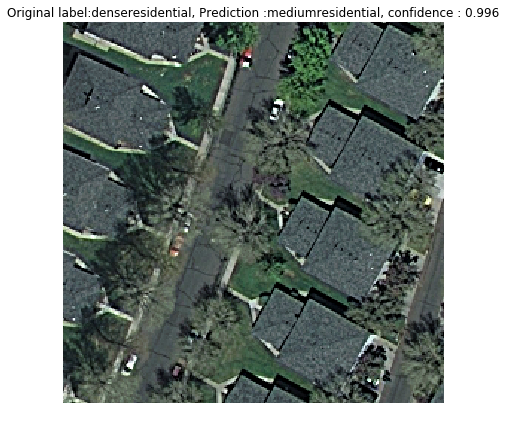

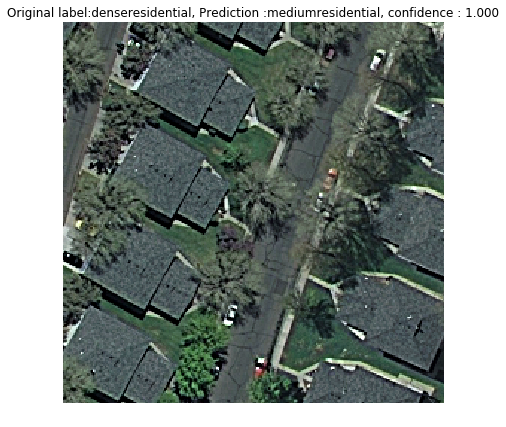

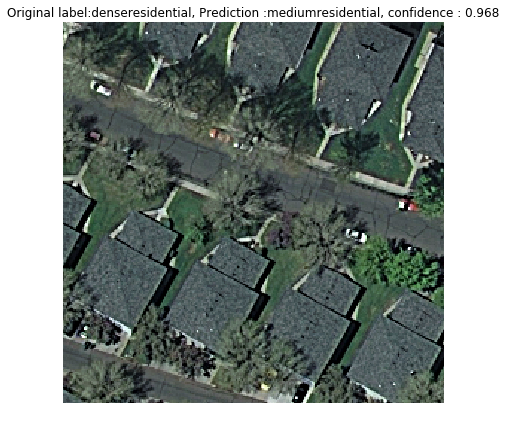

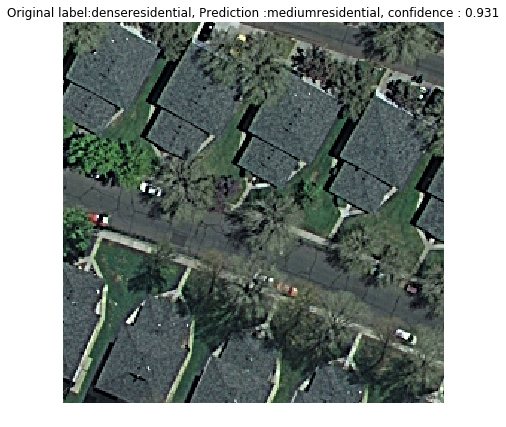

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


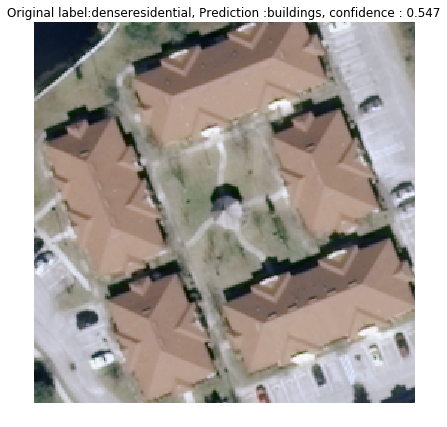

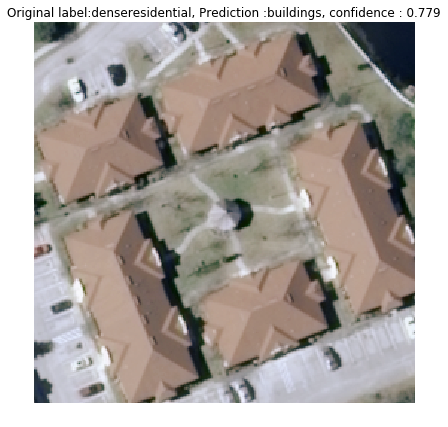

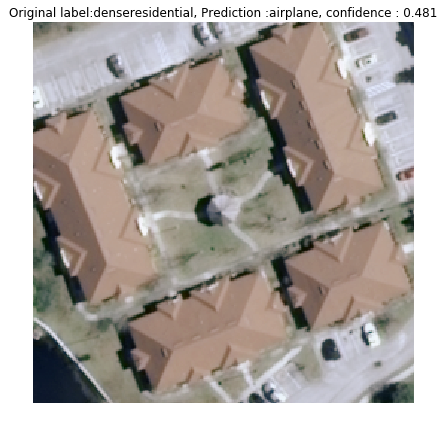

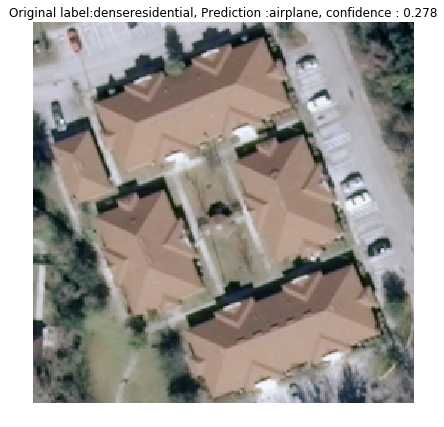

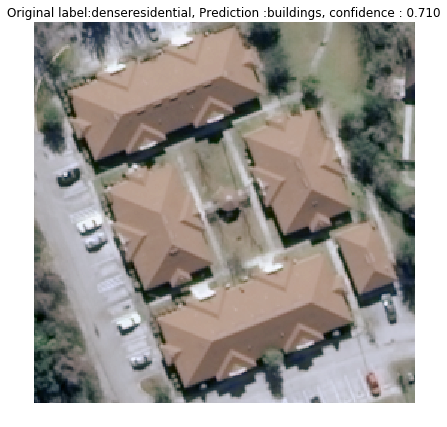

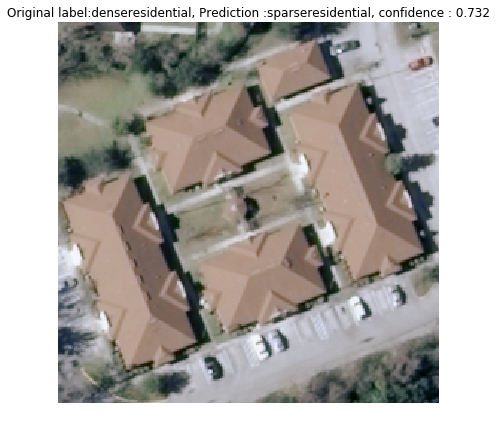

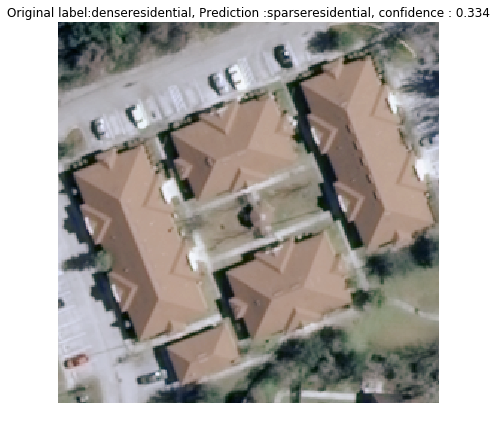

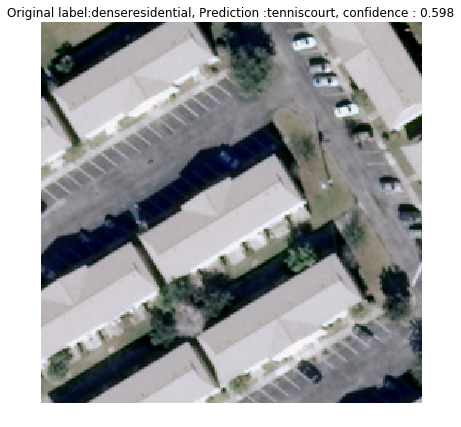

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


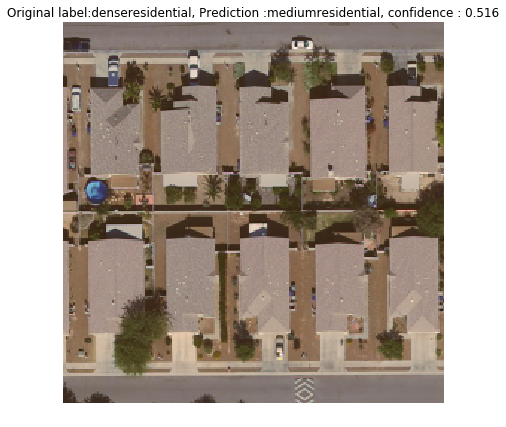

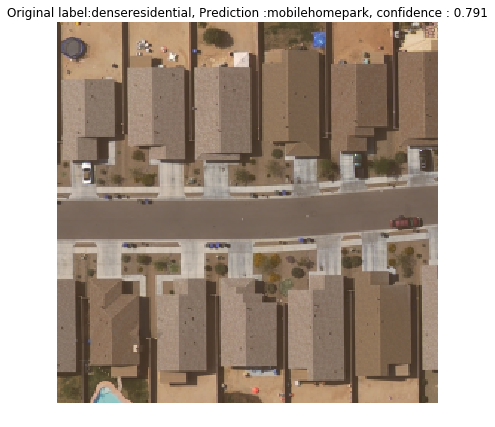

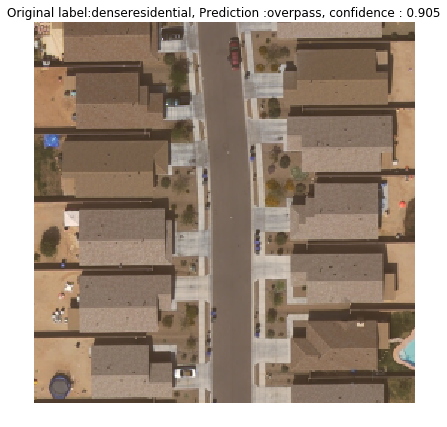

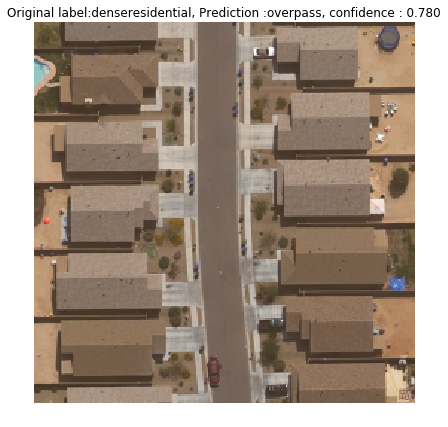

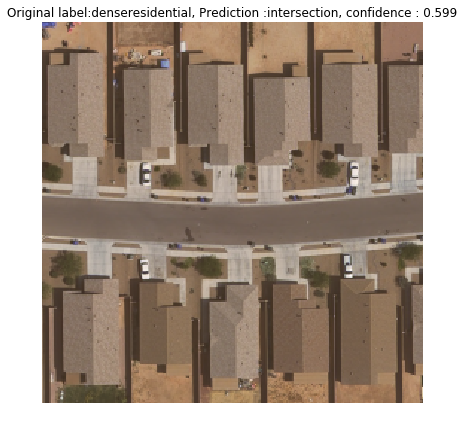

...

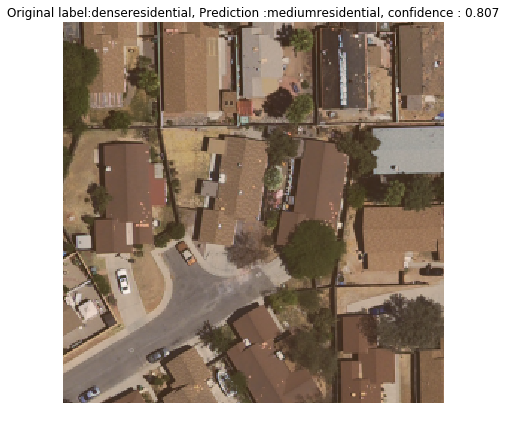

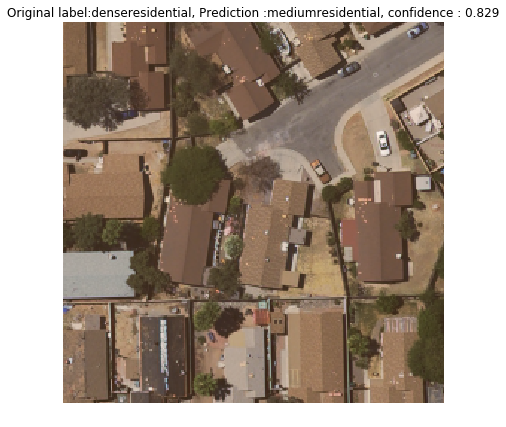

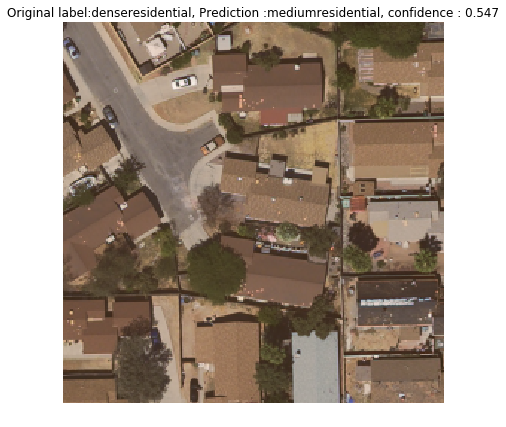

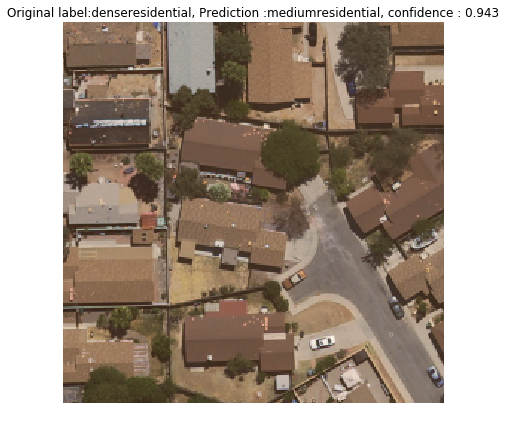

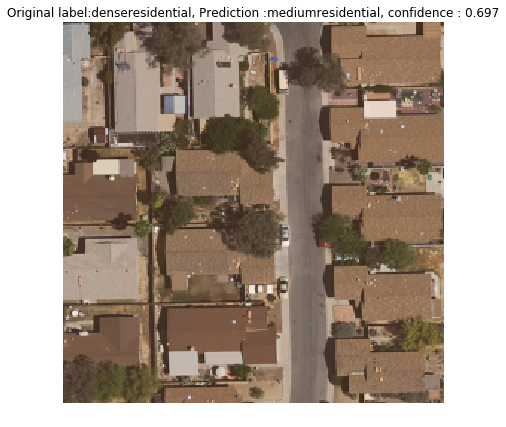

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


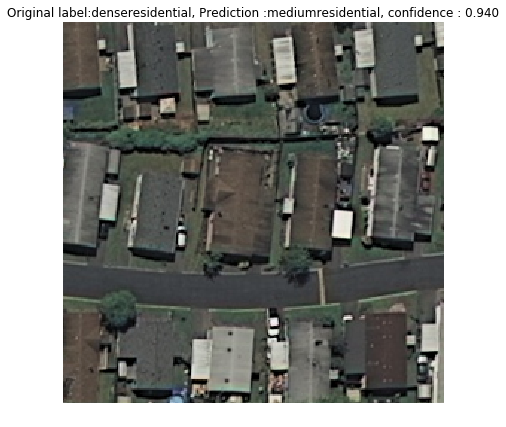

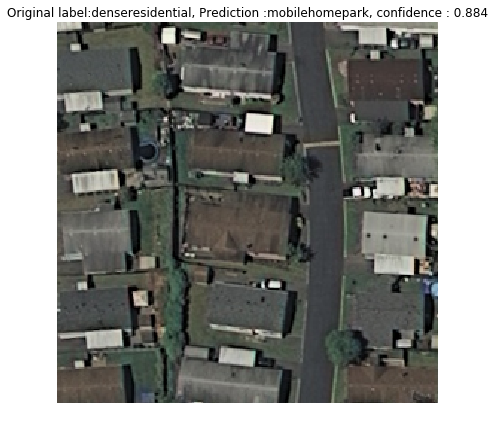

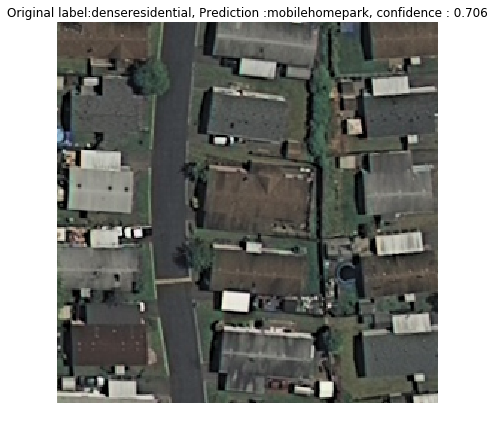

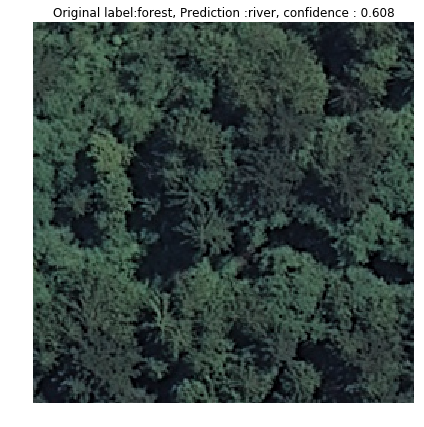

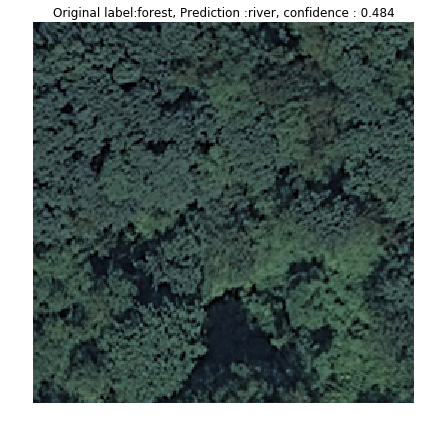

...

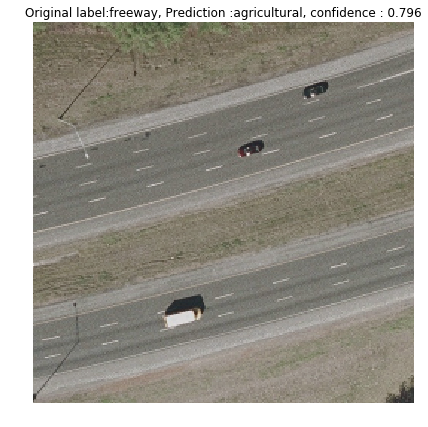

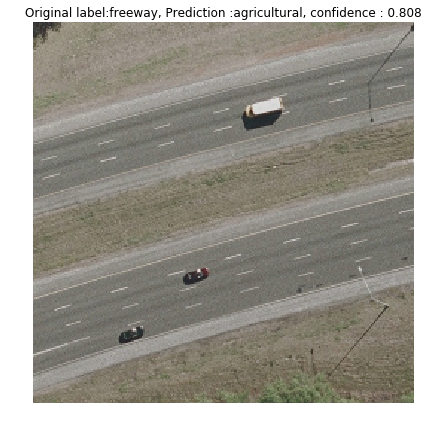

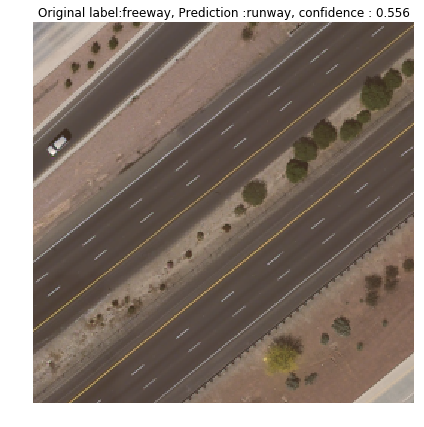

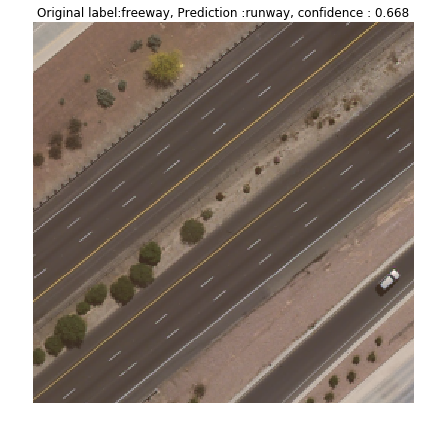

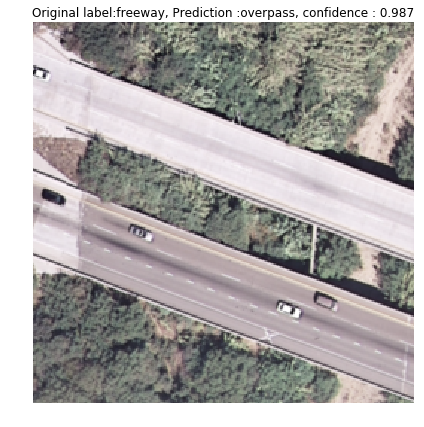

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


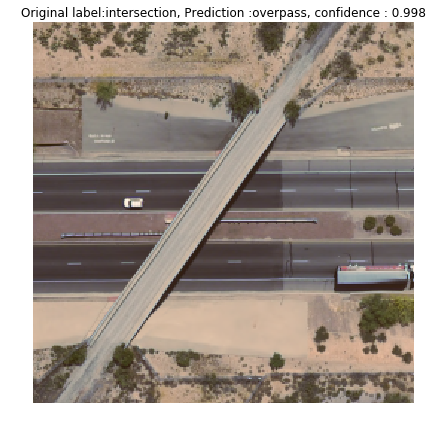

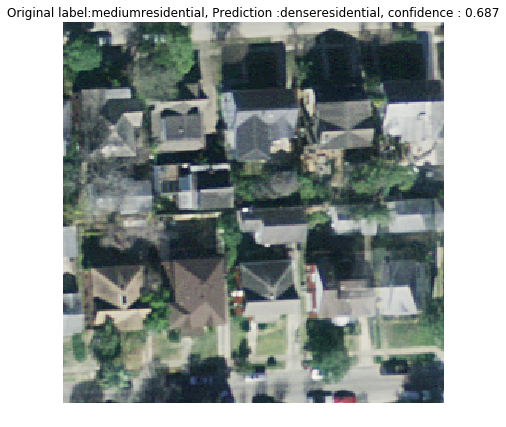

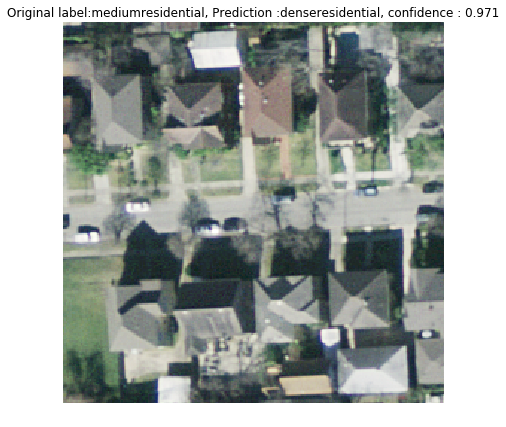

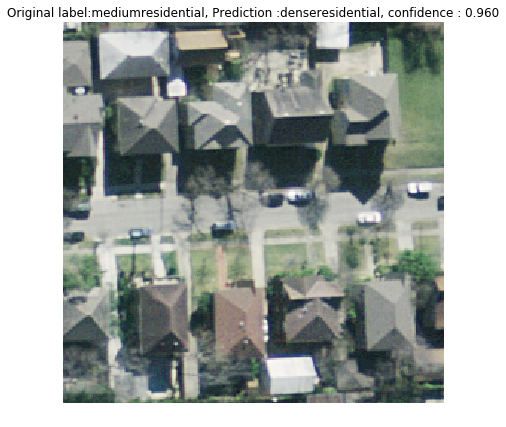

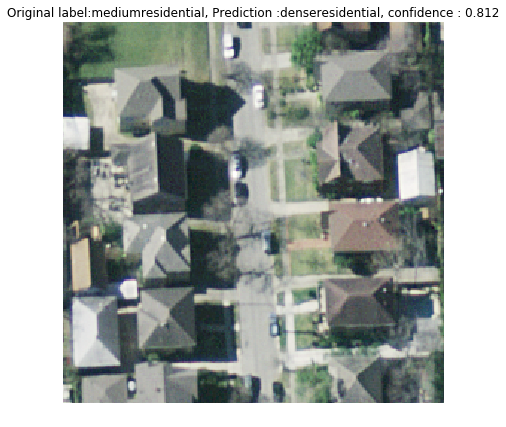

...

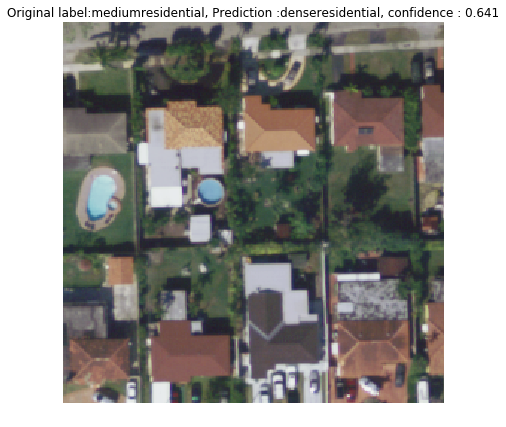

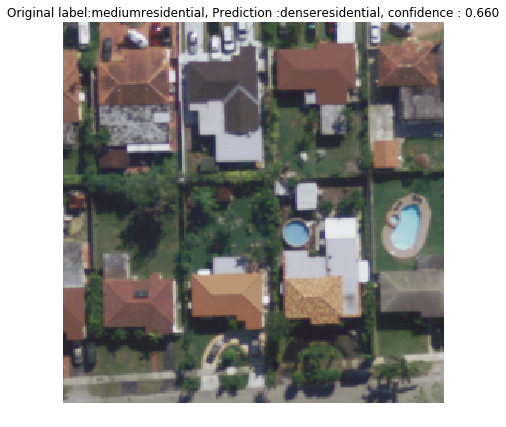

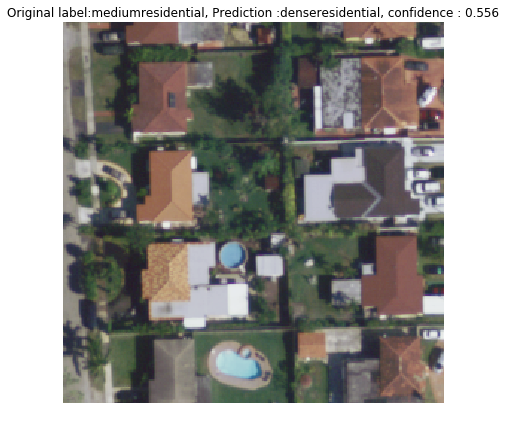

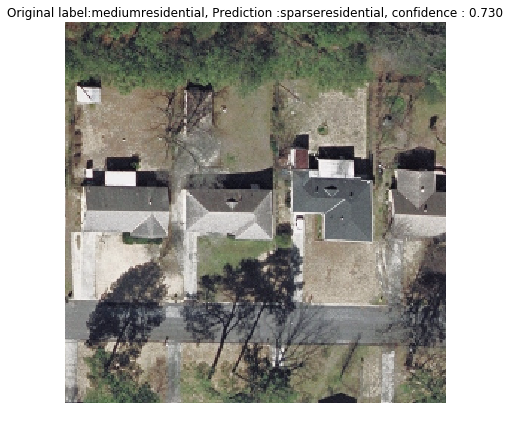

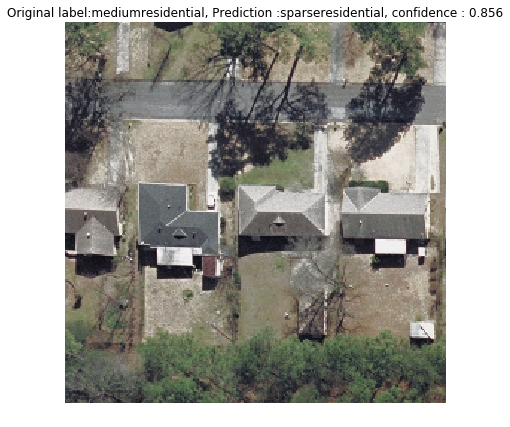

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


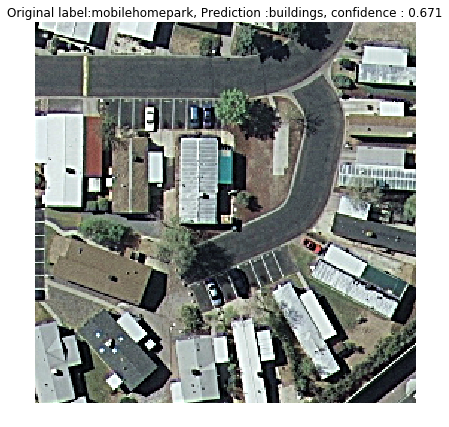

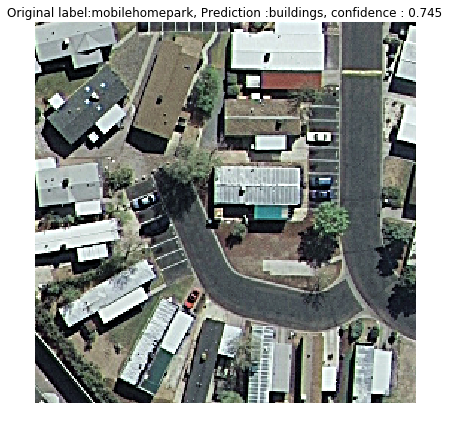

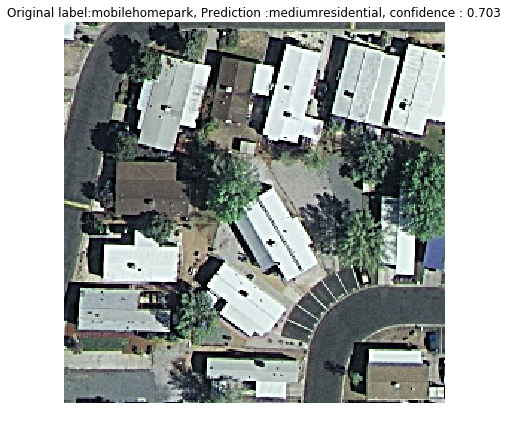

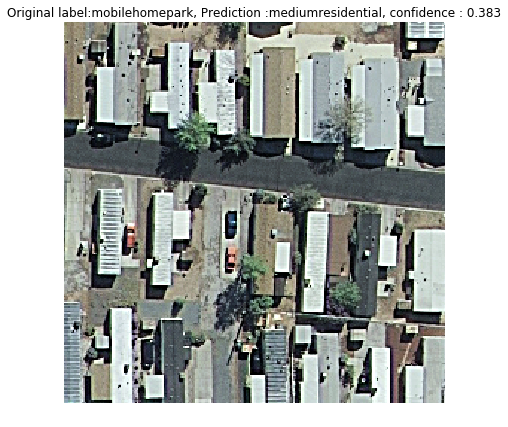

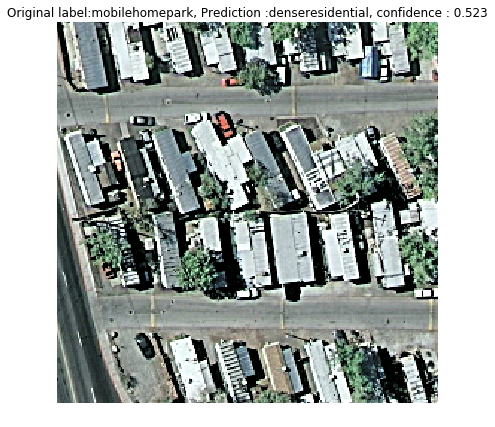

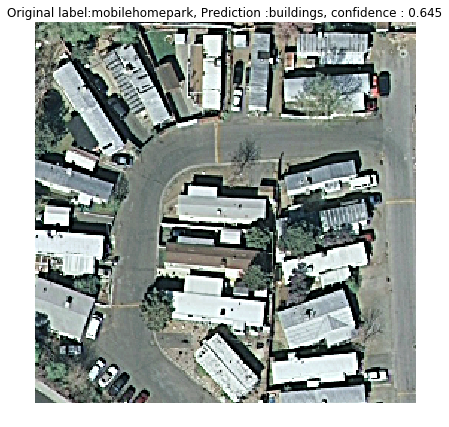

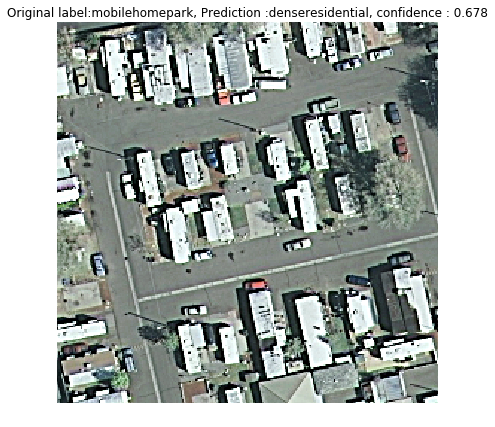

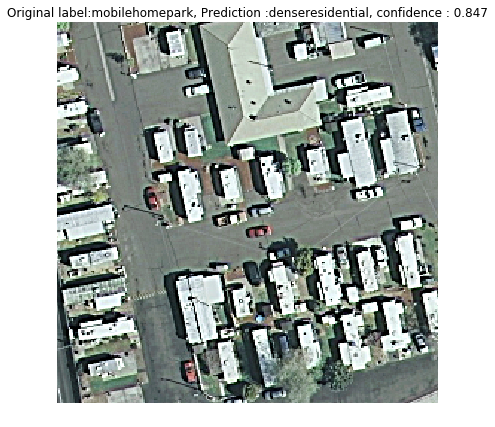

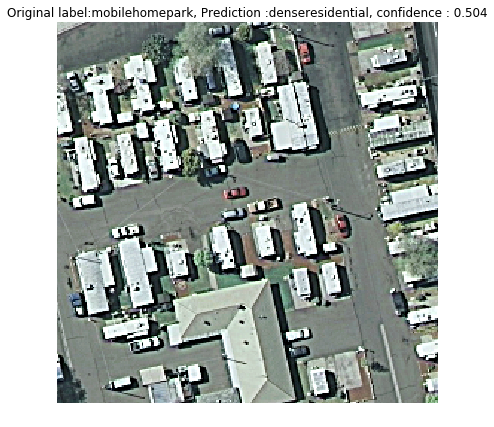

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


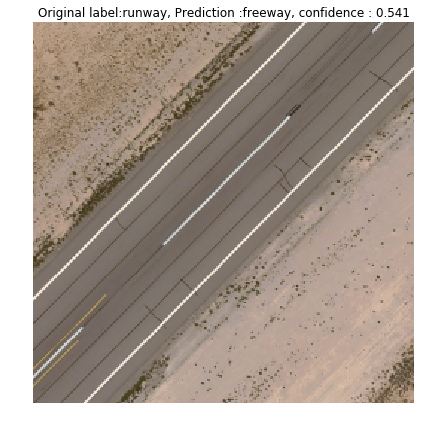

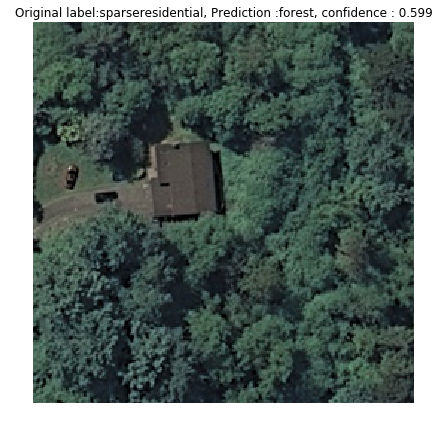

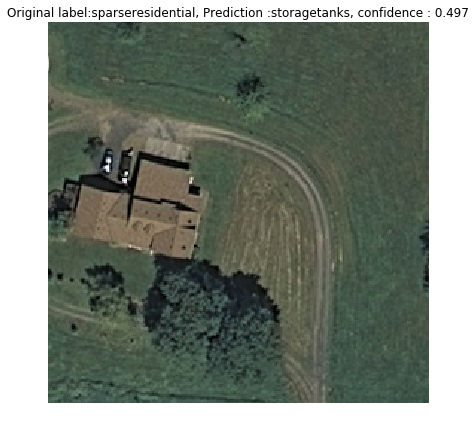

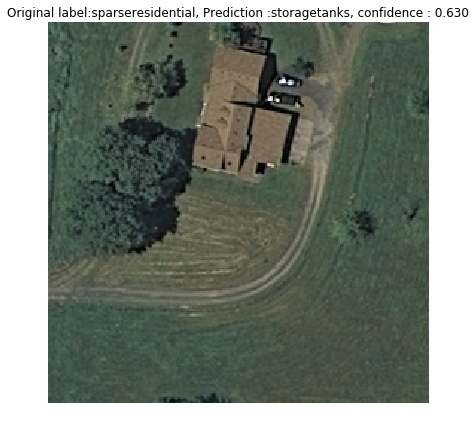

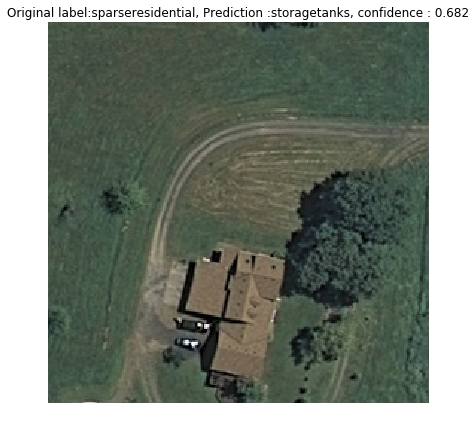

...

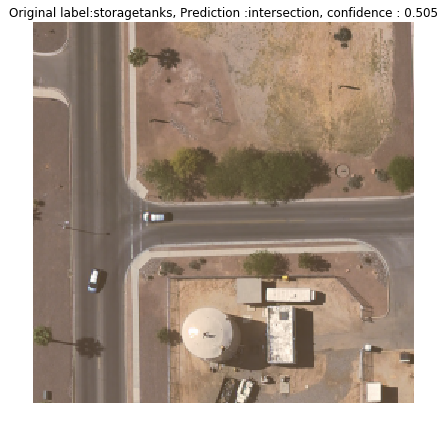

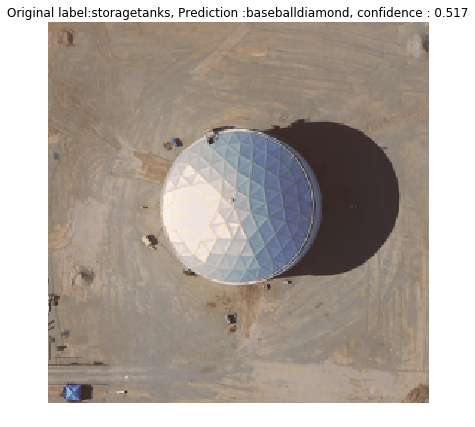

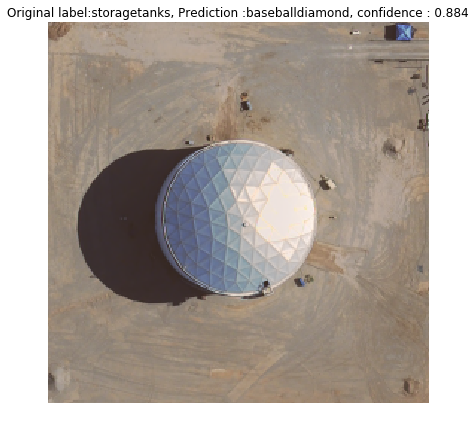

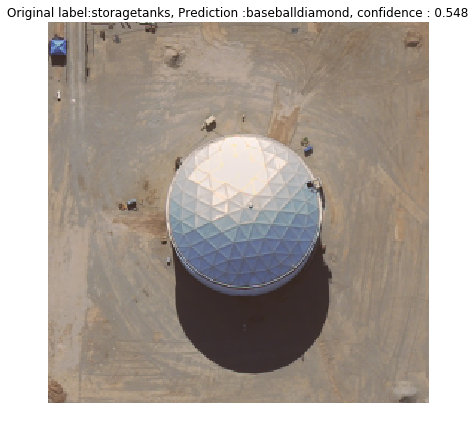

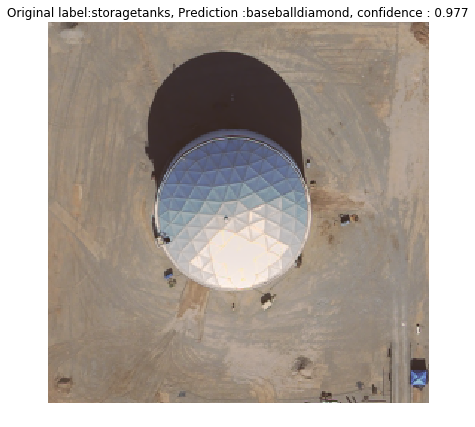

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


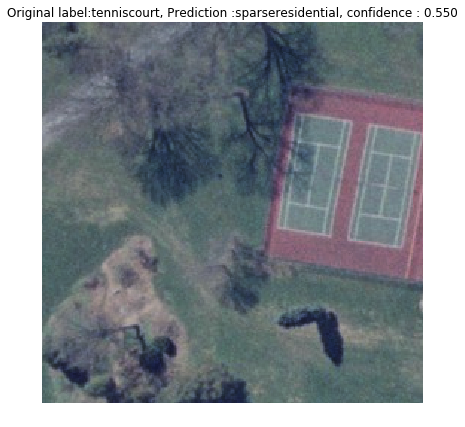

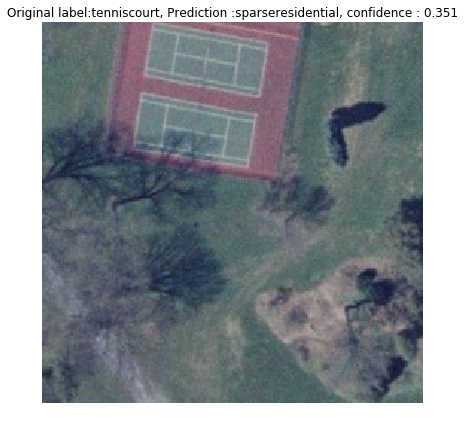

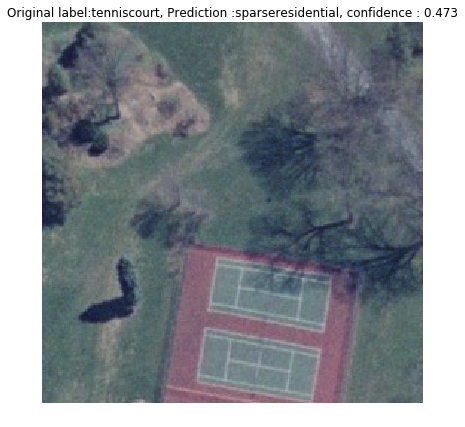

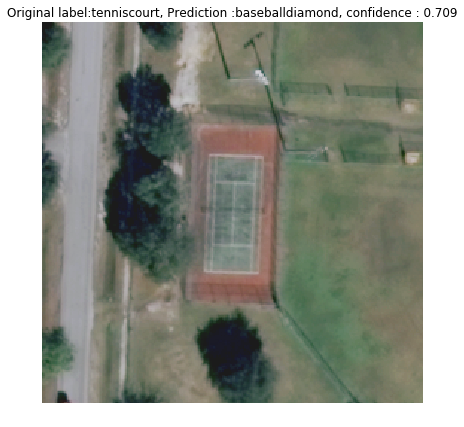

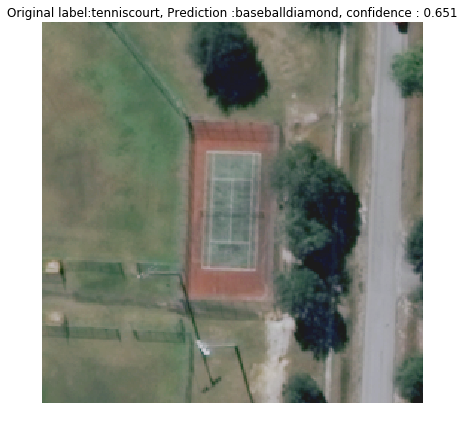

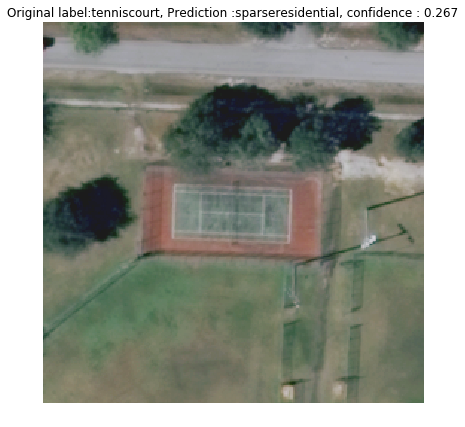

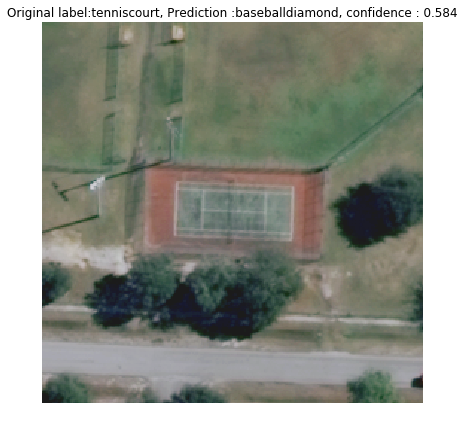

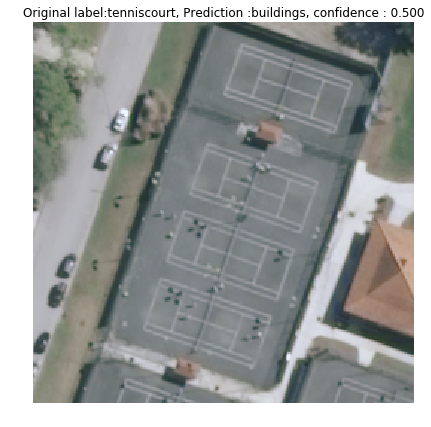

In [19]:
from keras.preprocessing.image import load_img
# Create a generator for prediction
validation_generator = validation_datagen.flow_from_directory(
        test_folder,
        target_size=(image_size, image_size),
        batch_size=val_batchsize,
        class_mode='categorical',
        shuffle=False)

# Get the filenames from the generator
fnames = validation_generator.filenames

# Get the ground truth from generator
ground_truth = validation_generator.classes

# Get the label to class mapping from the generator
label2index = validation_generator.class_indices

# Getting the mapping from class index to class label
idx2label = dict((v,k) for k,v in label2index.items())

# Get the predictions from the model using the generator
predictions = model.predict_generator(validation_generator, steps=validation_generator.samples/validation_generator.batch_size,verbose=1)
predicted_classes = np.argmax(predictions,axis=1)

errors = np.where(predicted_classes != ground_truth)[0]
print("No of errors = {}/{}".format(len(errors),validation_generator.samples))

# Show the errors
for i in range(len(errors)):
    pred_class = np.argmax(predictions[errors[i]])
    pred_label = idx2label[pred_class]
    
    title = 'Original label:{}, Prediction :{}, confidence : {:.3f}'.format(
        fnames[errors[i]].split('/')[0],
        pred_label,
        predictions[errors[i]][pred_class])
    
    original = load_img('{}/{}'.format(test_folder,fnames[errors[i]]))
    plt.figure(figsize=[7,7])
    plt.axis('off')
    plt.title(title)
    plt.imshow(original)
    plt.show()